# Experiment 2: Linear Models

12th March 2024

## Description

In this experiment, you will implement linear models, including linear regression, ridge regression, and logistic regression. You will also compare your implementation with the models in `sklearn`.

Write your code between the lines `########## Start/End of Your Code ##########`.

You should add some comments to keep readability of your code. If your code is not understandable, you will not receive full marks even if your results are correct.

You can add some markdown cells to explain your code if necessary. 

You can also add more cells if necessary.


In [1]:
# Import necessary libraries
# If you have not installed the libraries, you can install them by running `!pip install <name>` in a code cell
# You can add more libraries here if necessary, but avoid using highly integrated, function-calling libraries, e.g., sklearn, PyTorch, Tensorflow, etc.

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math


## Task 1: Linear Regression

Recall that in linear regression, we map a input vector $\boldsymbol{x}$ to a scalar output $y$ using the model

$$ y = \boldsymbol{w}^T \boldsymbol{x} + b $$

where $\boldsymbol{w}$ is the weight vector and $b$ is the bias term. To optimize the model, we may solve the following optimization problem with Gradient Descent (GD):

$$ \min_{\boldsymbol{w}, b} \ell(\boldsymbol{w}, b)=\frac{1}{2n} \sum_{i=1}^n (y_i - \boldsymbol{w}^T \boldsymbol{x}_i - b)^2 $$

where $(\boldsymbol{x}_i, y_i)$ is the $i$-th training example. In addition, the above optimization problem can also be written in matrix form:

$$ \min_{\boldsymbol{\beta}} J(\boldsymbol{\beta})=\frac{1}{2n} \|\mathbf{X}\boldsymbol{\beta}-\boldsymbol{y}\|^2 $$

where $\mathbf{X}$ is the feature matrix and $\boldsymbol{y}$ is the target vector. To solve the optimization problem, we can use the GD method to update the parameters iteratively until convergence:

$$ \boldsymbol{\beta} \leftarrow \boldsymbol{\beta} - \alpha \nabla J(\boldsymbol{\beta}) $$

where $\alpha$ is the learning rate and $\nabla J(\boldsymbol{\beta})$ is the gradient of the loss function with respect to $\boldsymbol{\beta}$.

In this task, we will implement a simple linear regression model to predict the disease progress of diabetes.


### Data Loading

The data set used in this task comes from the "Diabetes Dataset". Ten baseline variables, age, sex, body mass index, average blood pressure, and six blood serum measurements were obtained for each of 442 diabetes patients, as well as the response of interest, a quantitative measure of disease progression one year after baseline. The dataset is from [URL](https://www4.stat.ncsu.edu/~boos/var.select/diabetes.html). You can refer to [URL](https://scikit-learn.org/stable/datasets/toy_dataset.html#diabetes-dataset) for more information as well.

The dataset is ready for you and is stored in the file `diabetes_train.csv` and `diabetes_test.csv`. Each row in the file is a sample, with the last column being the label (disease progression one year after baseline) and the first 10 columns being the features.

Note: Each of these 10 feature variables have been mean centered and scaled by the standard deviation times the square root of samples (i.e. the sum of squares of each column totals 1).


In [2]:
# Load the data
# Requirements:
# - You can use the pandas library to load the data in 'diabetes_train.csv' and 'diabetes_test.csv' into a DataFrame
# - Save the training and test set features as X_train, X_test respectively, type: DataFrame
# - Save the training and test set targets as y_train, y_test respectively, type: Series
# - Concatenate X_train, X_test into a new variable named X for future use, type: DataFrame
# - Concatenate y_train, y_test into a new variable named y for future use, type: Series

########## Start of Your Code ##########

train = pd.read_csv('diabetes_train.csv')
test = pd.read_csv('diabetes_test.csv')
X_train = train.iloc[:, :-1]
y_train = train.iloc[:, -1]
X_test = test.iloc[:, :-1]
y_test = test.iloc[:, -1]

X = pd.concat([X_train, X_test], axis=0)
y = pd.concat([y_train, y_test], axis=0)

########## End of Your Code ##########

# Check the shape of the data
print(X_train.shape)  # (354, 10)
print(y_train.shape)  # (354,)
print(X_test.shape)  # (88, 10)
print(y_test.shape)  # (88,)


(354, 10)
(354,)
(88, 10)
(88,)


In [3]:
# Display the first few rows of the training set
X_train.head(5)


,age,sex,bmi,bp,s1,s2,s3,s4,s5,s6
0,0.038076,0.050680,0.061696,0.021872,-0.044223,-0.034821,-0.043401,-0.002592,0.019907,-0.017646
1,-0.001882,-0.044642,-0.051474,-0.026328,-0.008449,-0.019163,0.074412,-0.039493,-0.068332,-0.092204
2,0.085299,0.050680,0.044451,-0.005670,-0.045599,-0.034194,-0.032356,-0.002592,0.002861,-0.025930
3,-0.089063,-0.044642,-0.011595,-0.036656,0.012191,0.024991,-0.036038,0.034309,0.022688,-0.009362
4,0.005383,-0.044642,-0.036385,0.021872,0.003935,0.015596,0.008142,-0.002592,-0.031988,-0.046641


In [4]:
# Get some insights of the training set
X_train.describe()


,age,sex,bmi,bp,s1,s2,s3,s4,s5,s6
count,354.000000,354.000000,354.000000,354.000000,354.000000,354.000000,354.000000,354.000000,354.000000,354.000000
mean,0.000735,-0.000212,-0.000756,0.000178,0.000219,0.000269,0.000441,0.000040,-0.000189,-0.000645
std,0.048518,0.047619,0.046327,0.047502,0.047455,0.047336,0.048646,0.048830,0.047017,0.047259
min,-0.107226,-0.044642,-0.090275,-0.112399,-0.126781,-0.106845,-0.102307,-0.076395,-0.126097,-0.129483
25%,-0.037299,-0.044642,-0.035307,-0.036656,-0.033216,-0.030358,-0.036038,-0.039493,-0.031988,-0.030072
50%,0.005383,-0.044642,-0.007284,-0.005670,-0.004321,-0.003976,-0.006584,-0.002592,-0.001947,-0.001078
75%,0.038076,0.050680,0.031248,0.035644,0.027326,0.029140,0.030232,0.034309,0.030878,0.027917
max,0.110727,0.050680,0.160855,0.132044,0.153914,0.198788,0.181179,0.185234,0.133597,0.135612


In [5]:
# Get some insights of the training set
y_train.describe()


count    354.000000
mean     151.358757
std       76.215726
min       25.000000
25%       88.000000
50%      140.000000
75%      202.000000
max      346.000000
Name: target, dtype: float64

In [6]:
# Transform into numpy arrays for further operations
# numpy arrays are more useful for mathematical operations
# Requirements:
# - Transform X_train, X_test, y_train, y_test into numpy arrays
# - insert a column of ones to the feature matrices to simplify the calculation of the bias term
# - Save the transformed training and test set features still as X_train, X_test respectively, type: ndarray
# - Save the transformed training and test set targets still as y_train, y_test respectively, type: ndarray

########## Start of Your Code ##########

X_train = np.array(X_train)
X_train = np.insert(X_train, X_train.shape[1], values=1, axis=1)  # add a column of ones
y_train = np.array(y_train)

X_test = np.array(X_test)
X_test = np.insert(X_test, X_test.shape[1], values=1, axis=1)  # add a column of ones
y_test = np.array(y_test)

########## End of Your Code ##########

# Check the shape of the data
print(X_train.shape)  # (354, 11)
print(y_train.shape)  # (354,)
print(X_test.shape)  # (88, 11)
print(y_test.shape)  # (88,)


(354, 11)
(354,)
(88, 11)
(88,)


### Model Implementation

Now we will implement the linear regression model. The model should be able to:
- Fit the training set
- Make predictions on the test set
- Calculate the mean squared error (MSE) of the test set

In this task, you are asked to use the Gradient Descent (GD) method to solve the optimization problem. You should not use the closed-form solution.


In [7]:
# Implement the linear regression model
# Requirements:
# - Write the three methods for the LinearRegressionModel class: fit, predict, score
# - The fit method should use the GD method to solve the optimization problem
# - You can add more methods to the class if you would like to

# Tips:
# - Gradient Descent may take a long time, you can print the MSE in training process to check if the model is learning
# - You can tune the learning rate if the model is not learning well
# - A better initialization of the weights and bias can lead to faster convergence. You can initialize 
# the bias term to the mean of the targets for quicker convergence (for this dataset only)
# - Do not worry if the model is not learning well, just keep it and do not spend too much time on it

class LinearRegressionModel:
    def __init__(self, alpha, threshold, max_iter):
        # These hyperparameters are used to control the model training process, you can add more or delete some
        self.beta = None  # weights and bias, parameters of the model
        self.alpha = alpha  # learning rate
        self.threshold = threshold  # threshold for the stopping condition (you can self-define the stopping condition)
        self.max_iter = int(max_iter)  # maximum number of iterations

    def fit(self, X, y):  # Fit the training data given training data X and targets y
        ########## Start of Your Code ##########
        self.beta = np.random.normal(loc=0.0, scale=0.01, size=X.shape[1])
        for i in range(self.max_iter):
            new_beta = self.beta - self.alpha * X.T @ (X @ self.beta - y) / X.shape[0]
            if np.linalg.norm(new_beta - self.beta) < self.threshold:
                break
            if i % 10000 == 0:
                print(f"Current round: {i}, MSE: {self.score(X, y)}, weight difference: {np.linalg.norm(new_beta - self.beta)}")
            self.beta = new_beta
        ########## End of Your Code ##########
        return self

    def predict(self, X):  # Make predictions on unseen test data X
        ########## Start of Your Code ##########
        y_pred = X @ self.beta
        ########## End of Your Code ##########
        return y_pred

    def score(self, X, y):  # Predict and compare to true labels y
        ########## Start of Your Code ##########
        y_pred = self.predict(X)
        score = ((y_pred - y) ** 2).sum() / X.shape[0]  # Mean Squared Error
        ########## End of Your Code ##########
        return score


In [8]:
# Use the linear regression model defined by yourself to fit the training set
alpha, threshold, max_iter = 1e-2, 1e-4, 1e7  # You can change these hyperparameters
linear_regression_model = LinearRegressionModel(alpha, threshold, max_iter)
linear_regression_model.fit(X_train, y_train)


Current round: 0, MSE: 28707.17424307425, weight difference: 1.5143670204389523
Current round: 10000, MSE: 3885.2305896092685, weight difference: 0.020546043202929867
Current round: 20000, MSE: 3386.5432497198067, weight difference: 0.012026332224513572
Current round: 30000, MSE: 3182.0085408484174, weight difference: 0.008533053422992173
Current round: 40000, MSE: 3068.797858851822, weight difference: 0.0066155710190122724
Current round: 50000, MSE: 2998.5257345909913, weight difference: 0.005279514243563366
Current round: 60000, MSE: 2953.300166454562, weight difference: 0.00425416585779667
Current round: 70000, MSE: 2923.798860547052, weight difference: 0.0034437561960369797
Current round: 80000, MSE: 2904.403204692211, weight difference: 0.002797403660539234
Current round: 90000, MSE: 2891.564770834255, weight difference: 0.0022800918847479964
Current round: 100000, MSE: 2883.006904638971, weight difference: 0.0018652740906501496
Current round: 110000, MSE: 2877.2581179762674, weig

In [9]:
# Check the performance of the model
print(linear_regression_model.score(X_train, y_train))
print(linear_regression_model.score(X_test, y_test))


2856.6169544027416
2939.905274658998


## Task 2: Ridge Regression


In short, the ridge regression is just the linear regression with an extra regular term added. To better optimize the model, we may solve the following optimization problem with Gradient Descent (GD):

$$ \min_{\boldsymbol{w}, b} \ell(\boldsymbol{w}, b)=\frac{1}{2n} \sum_{i=1}^n (y_i - \boldsymbol{w}^T \boldsymbol{x}_i - b)^2  + \lambda \sum_{j=1}^p \boldsymbol{\beta}_{j}^2$$

where $\lambda$ is a hyperparameter serving as the coefficient of the regularization term, and $\boldsymbol{\beta} = \{ \boldsymbol{\beta}_{0}, \boldsymbol{\beta}_{1}, ..., \boldsymbol{\beta}_{p}  \}$ is the model parameter vector. In addition, the above optimization problem can also be written in matrix form:

$$ \min_{\boldsymbol{\beta}} J(\boldsymbol{\beta})=\frac{1}{2n} \|\mathbf{X}\boldsymbol{\beta}-\boldsymbol{y}\|^2  + \lambda \sum_{j=1}^p \boldsymbol{\beta}_{j}^2$$

where all other symbols have the same meaning as in Task 1.

### Data Loading 

For convenience, you can directly use the data loaded in Task 1.

### Model Implementation

Now we will implement the ridge regression model. The model should be able to:
- Fit the training set
- Make predictions on the test set
- Calculate the mean squared error (MSE) of the test set

In this task, you are asked to use the Gradient Descent (GD) method to solve the optimization problem. You should not use the closed-form solution.

In [10]:
# Implement the ridge regression model
# Requirements:
# - Write the three methods for the RidgeRegressionModel class: fit, predict, score
# - The fit method should use the GD method to solve the optimization problem
# - You can add more methods to the class if you would like to

# Tips:
# - Gradient Descent may take a long time, you can print the MSE in training process to check if the model is learning
# - You can tune the learning rate if the model is not learning well
# - A better initialization of the weights and bias can lead to faster convergence. You can initialize 
# the bias term to the mean of the targets for quicker convergence (for this dataset only)
# - Do not worry if the model is not learning well, just keep it and do not spend too much time on it

class RidgeRegressionModel:
    def __init__(self, alpha, threshold, max_iter, lambda_value):
        # These hyperparameters are used to control the model training process, you can add more or delete some
        self.beta = None  # weights and bias, parameters of the model
        self.alpha = alpha  # learning rate
        self.threshold = threshold  # threshold for the stopping condition (you can self-define the stopping condition)
        self.max_iter = int(max_iter)  # maximum number of iterations
        self.lambda_value = lambda_value

    def fit(self, X, y):  # Fit the training data given training data X and targets y
        ########## Start of Your Code ##########
        #self.beta = np.random.random(X.shape[1]) * 2 - 1
        np.random.seed(0)
        self.beta = np.random.normal(loc=0.0, scale=0.01, size=X.shape[1])
        self.beta[-1] = y.mean()  # Initialize the bias term to the mean of the targets, which is a good starting point
        for i in range(self.max_iter):
            new_beta = self.beta - self.alpha * ( X.T @ (X @ self.beta - y) / X.shape[0] + 2 * self.lambda_value * self.beta )
            if np.linalg.norm(new_beta - self.beta) < self.threshold:
                break
            if i % 100 == 0:
                print(f"Current round: {i}, MSE: {self.score(X, y)}, weight difference: {np.linalg.norm(new_beta - self.beta)}")
            self.beta = new_beta
        ########## End of Your Code ##########
        return self

    def predict(self, X):  # Make predictions on unseen test data X
        ########## Start of Your Code ##########
        y_pred = X @ self.beta
        ########## End of Your Code ##########
        return y_pred

    def score(self, X, y):  # Predict and compare to true labels y
        ########## Start of Your Code ##########
        y_pred = self.predict(X)
        score = ((y_pred - y) ** 2).sum() / X.shape[0]  # Mean Squared Error
        ########## End of Your Code ##########
        return score

In [11]:
# Use the ridge regression model defined by yourself to fit the training set
alpha, threshold, max_iter, lambda_value = 1e-2, 1e-4, 1e7, 1e-4 # You can change these hyperparameters
ridge_regression_model = RidgeRegressionModel(alpha, threshold, max_iter, lambda_value)
ridge_regression_model.fit(X_train, y_train)


Current round: 0, MSE: 5792.303588053106, weight difference: 0.043508484138262055
Current round: 100, MSE: 5754.759427141057, weight difference: 0.04314078612269636
Current round: 200, MSE: 5717.837528311578, weight difference: 0.042777575381006086
Current round: 300, MSE: 5681.52650518978, weight difference: 0.0424180281526937
Current round: 400, MSE: 5645.815456731776, weight difference: 0.04206200460429085
Current round: 500, MSE: 5610.6936478559055, weight difference: 0.041709457538998525
Current round: 600, MSE: 5576.150510333789, weight difference: 0.041360352530057494
Current round: 700, MSE: 5542.175656889588, weight difference: 0.04101465713118095
Current round: 800, MSE: 5508.758886242792, weight difference: 0.0406723394168283
Current round: 900, MSE: 5475.890183012971, weight difference: 0.04033336778258603
Current round: 1000, MSE: 5443.5597155358, weight difference: 0.039997710915775614
Current round: 1100, MSE: 5411.757832921938, weight difference: 0.03966533778906322
Cur

In [12]:
# Check the performance of the model
print(ridge_regression_model.score(X_train, y_train))
print(ridge_regression_model.score(X_test, y_test))


2873.667159582554
2984.9184870388763


### Cross-validation

In Task 1, we used a fixed number of top 354 to divide the training set and the test set, but this division may be biased and will also bias the evaluation of the model and hyperparameters. Therefore, in order to minimize the bias caused by data partition as much as possible, we use $k$-fold cross-validation and take $k=5$ here.
- Divide the data into $k$ folds
- Use cross validation in pipeline
- Visualize the loss 

In [13]:
# Divide the shuffled dataset into k folds
k = 5
n_samples = X.shape[0]
fold_size = math.ceil(n_samples/ k)

# Add a column of ones to the feature matrices to simplify the calculation of the bias term
X['bias'] = 1

# Shuffle both X and Y using the same permutation of indices
indices = np.random.permutation(n_samples)
X = X.iloc[indices]
y = y.iloc[indices]

X_folds = []
y_folds = []
start = 0
for i in range(k):
    if i == k - 1:
        X_folds.append(X[start:])
        y_folds.append(y[start:])
    else :
        end = start + fold_size
        X_folds.append(X[start:end])
        y_folds.append(y[start:end])
        start = end


In [15]:
# Cross-validate lambda for the ridge regression model
# Requirements:
# - We have provided a pipeline function for you below
# - Fill in the blank inside the function

def pipline_crossval(alpha, threshold, max_iter, lambda_value_list, X_folds, y_folds): 
    train_loss_list = []
    test_loss_list  = []
    
    for lambda_value in lambda_value_list:
        train_loss = []  # store the loss of each fold
        test_loss  = []
        
        for i in range(len(X_folds)):
            X_Train = X_folds[:i] + X_folds[i + 1:]
            X_Train = np.concatenate(X_Train, axis=0)
            y_Train = y_folds[:i] + y_folds[i + 1:]
            y_Train = np.concatenate(y_Train, axis=0)
            ########## Start of Your Code ##########
            ridge_regression_model = RidgeRegressionModel(alpha, threshold, max_iter, lambda_value)
            ridge_regression_model.fit(X_Train, y_Train)
            train_loss.append(ridge_regression_model.score(X_Train, y_Train))
            test_loss.append(ridge_regression_model.score(X_folds[i], y_folds[i]))
            print(train_loss)
            ########## End of Your Code ##########
        
        train_loss_list.append(np.mean(train_loss))  # store the average loss of all folds as the final loss for the current lambda
        test_loss_list.append(np.mean(test_loss))  
    
    # Draw the loss curve
    plt.plot([-math.log10(x) for x in lambda_value_list], train_loss_list, linestyle="-", marker="o", label="train_loss", linewidth=1)
    plt.plot([-math.log10(x) for x in lambda_value_list], test_loss_list, linestyle="-", marker="o", label="test_loss", linewidth=1)
    plt.grid()
    plt.xlabel('Log(Lambda Value)',font={'family':'Times New Roman', 'size':25})
    plt.xticks(fontsize=25)
    plt.locator_params(axis='x', nbins=5)
    plt.ylabel('Loss',font={'family':'Times New Roman', 'size':25})
    plt.yticks(fontsize=25)
    plt.locator_params(axis='y', nbins=5)
    plt.legend()
    plt.tight_layout()
    

Current round: 0, MSE: 5859.458317248908, weight difference: 3.0011714623617776
Current round: 100, MSE: 14919.9679652783, weight difference: 0.1428020232158168
Current round: 200, MSE: 15801.668442049911, weight difference: 0.006823172548298384
Current round: 300, MSE: 15844.446483341455, weight difference: 0.0003361001020035786
[15845.976102983126]
Current round: 0, MSE: 6244.541141971079, weight difference: 3.1098677076020524
Current round: 100, MSE: 15970.429468997514, weight difference: 0.1480238498415709
Current round: 200, MSE: 16916.58511321329, weight difference: 0.007090749237919702
Current round: 300, MSE: 16962.44034092768, weight difference: 0.00035549827132420794
[15845.976102983126, 16964.13070206977]
Current round: 0, MSE: 5702.904774091023, weight difference: 2.985803804061211
Current round: 100, MSE: 14671.905309503189, weight difference: 0.14206075420151307
Current round: 200, MSE: 15544.773475404063, weight difference: 0.006784665262808374
Current round: 300, MSE: 1

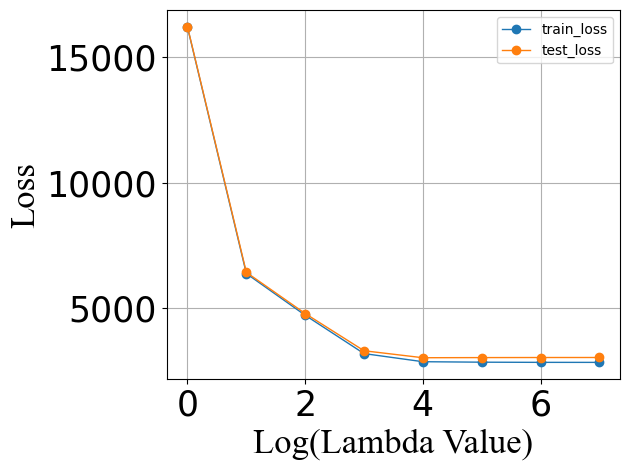

In [17]:
# Cross-validate lambda for the ridge regression model
lambda_value_list = [10 ** (-i) for i in range(7)]  # Possible lambda values, you can change this list
alpha, threshold, max_iter= 1e-2, 1e-4, 1e7  # You can change these hyperparameters
pipline_crossval(alpha, threshold, max_iter, lambda_value_list, X_folds, y_folds)


## Task 3: Logistic Regression

Recall that in logistic regression, we map a input vector $\boldsymbol{x}$ to a posterior probability $p(y|\boldsymbol{x})$ using the model

$$ p(y=1|\boldsymbol{x}) = \frac{1}{1+e^{-(\boldsymbol{w}^\text{T} \boldsymbol{x} + b)}} $$

where $\boldsymbol{w}$ is the weight vector and $b$ is the bias term, and return whichever label ($y$ = 1 or $y$ = 0) is higher probability. To optimize the model, we may solve the following optimization problem with Gradient Descent (GD):

$$ \min_{\boldsymbol{\beta}} \ell(\boldsymbol{\beta})=\frac{1}{n} \sum_{i=1}^n(-y_i \boldsymbol{\beta}^\text{T} \boldsymbol{\hat{x}}_i + \ln(1+e^{\boldsymbol{\beta}^\text{T} \boldsymbol{\hat{x}}_i}))$$

where $(\boldsymbol{x}_i, y_i)$ is the $i$-th training example, $\boldsymbol{\beta}=(\boldsymbol{w};b)$ and $\boldsymbol{\hat{x}}=(\boldsymbol{x};1)$. To solve the optimization problem, we can use the GD method to update the parameters iteratively until convergence:

$$ \boldsymbol{\beta} \leftarrow \boldsymbol{\beta} - \alpha \nabla J(\boldsymbol{\beta}) $$

where $\alpha$ is the learning rate and $\nabla J(\boldsymbol{\beta})$ is the gradient of the loss function with respect to $\boldsymbol{\beta}$.

In this task, we will implement a logistic regression model.


### Data Loading
The dataset is ready for you and is stored in the file `pendigit_train.csv` and `pendigit_test.csv`. Each row in the file is a sample, with the last column being the label  and the first 16 columns being the features.

Note: Each of these 16 feature variables have been normalized to 0-1.

In [16]:
# Load the data
# Requirements:
# - You can use the pandas and numpy to load the data in 'pendigit_train.csv' and 'pendigit_test.csv'into the ndarray type.
# - insert a column of ones to the feature matrices to simplify the calculation of the bias term
# - Save the training and test set features as X_train, X_test respectively, type: ndarray
# - Save the training and test set targets as y_train, y_test respectively, type: ndarray

########## Start of Your Code ##########
train_data = np.array(pd.read_csv('pendigit_train.csv'))
test_data = np.array(pd.read_csv('pendigit_test.csv'))

X_train = train_data[:,:-1]
y_train = train_data[:,-1]
X_test = test_data[:,:-1]
y_test = test_data[:,-1]
X_train = np.insert(X_train, X_train.shape[1], values=1, axis=1)  # add a column of ones
X_test = np.insert(X_test, X_test.shape[1], values=1, axis=1)  # add a column of ones

########## End of Your Code ##########

# Check the shape of the data
print(X_train.shape)  # (1828, 17)
print(y_train.shape)  # (1828,)
print(X_test.shape)  # (457, 17)
print(y_test.shape)  # (457,)


(1828, 17)
(1828,)
(457, 17)
(457,)


### Model Implementation

Now we will implement the logistic regression model. The model should be able to:
- Fit the training set
- Make predictions on the test set
- Calculate the accuracy (ACC) of the test set

In this task, you are asked to use the Gradient Descent (GD) method to solve the optimization problem. You should not use the closed-form solution.


In [17]:
# Implement the logistic regression model
# Requirements:
# - Write the three methods for the LogisticRegressionModel class: fit, predict, predict_prob, score, sigmoid
# - The fit method should use the GD method to solve the optimization problem
# - You can add more methods to the class if you would like to

# Tips:
# - Gradient Descent may take a long time, you can print the related information in training process to check if the model is learning
# - You can tune the learning rate if the model is not learning well
# - A better initialization of the weights and bias can lead to faster convergence. You can initialize 
# the bias term to the mean of the targets for quicker convergence (for this dataset only)
# - Do not worry if the model is not learning well, just keep it and do not spend too much time on it

class LogisticRegressionModel:
    def __init__(self, alpha, threshold, max_iter):
        self.beta = None  # weights and bias, parameters of the model
        self.alpha = alpha  # learning rate
        self.threshold = threshold  # threshold for the stopping condition (you can self-define the stopping condition)
        self.max_iter = int(max_iter)  # maximum number of iterations

    def sigmoid(self,z):
        return 1 / (1 + np.exp(-z))

    def fit(self, X, y):  # Fit the training data given training data X and targets y
        ########## Start of Your Code ##########
        self.beta = np.random.normal(loc=0.0, scale=0.01, size=X.shape[1])
        for i in range(self.max_iter):
            h = self.sigmoid(np.dot(X, self.beta))
            gradient = np.dot(X.T, (h - y)) / X.shape[0]
            new_beta = self.beta - self.alpha*gradient
            if np.linalg.norm(new_beta - self.beta) < self.threshold:
                print(
                 f"Current round: {i}, ACC: {self.score(X, y)}, weight difference: {np.linalg.norm(new_beta - self.beta)}")
                break
            if i % 1000 == 0:
                print(
                    f"Current round: {i}, ACC: {self.score(X, y)}, weight difference: {np.linalg.norm(new_beta - self.beta)}")
            self.beta = new_beta
        ########## End of Your Code ##########
        return self

    def predict(self, X):  # Make predictions on unseen test data X
        ########## Start of Your Code ##########
        y_prob = self.predict_prob(X)
        y_pred = y_prob>=0.5
        ########## End of Your Code ##########
        return y_pred
    
    def predict_prob(self, X): # Make predicted probabilities on unseen test data X
        ########## Start of Your Code ##########
        y_prob = self.sigmoid(X @ self.beta)
        ########## End of Your Code ##########
        return y_prob
    
    
    def score(self, X, y):  # Predict and compare to true labels y
        ########## Start of Your Code ##########
        from sklearn.metrics import accuracy_score
        y_pred = self.predict(X)
        score = accuracy_score(y, y_pred)
        ########## End of Your Code ##########
        return score
    

In [18]:
# Use the logistic regression model defined by yourself to fit the training set
alpha, threshold, max_iter = 1e-2, 1e-4, 1e7  # You can change these hyperparameters
logistic_regression_model = LogisticRegressionModel(alpha, threshold, max_iter)
logistic_regression_model.fit(X_train, y_train)


Current round: 0, ACC: 0.7833698030634574, weight difference: 0.004474740898718392
Current round: 1000, ACC: 0.9896061269146609, weight difference: 0.0010559589014795447
Current round: 2000, ACC: 0.9901531728665208, weight difference: 0.0005653985398703655
Current round: 3000, ACC: 0.9901531728665208, weight difference: 0.0003875527245074912
Current round: 4000, ACC: 0.9901531728665208, weight difference: 0.00029728641487532746
Current round: 5000, ACC: 0.9901531728665208, weight difference: 0.00024309544660285187
Current round: 6000, ACC: 0.9907002188183808, weight difference: 0.00020708722121573817
Current round: 7000, ACC: 0.9907002188183808, weight difference: 0.00018146557747314267
Current round: 8000, ACC: 0.9912472647702407, weight difference: 0.00016230798147005973
Current round: 9000, ACC: 0.9912472647702407, weight difference: 0.00014743327948497302
Current round: 10000, ACC: 0.9912472647702407, weight difference: 0.00013553576401926725
Current round: 11000, ACC: 0.9912472647

In [19]:
print(logistic_regression_model.score(X_train, y_train))
print(logistic_regression_model.score(X_test, y_test))


0.9912472647702407
0.9956236323851203


## Task 4: Comparing with the models in sklearn
Now that you have completed the linear regression, ridge regression and logistic regression implementation, compare these with standard models in sklearn. Then, discuss the difference between them and try to analyze the possible reasons.


In [20]:
# Comparison
# Requirements:
# - Compare the models you implemented with the models in sklearn with yours, and try to analyze the possible reasons for the difference
# - You can use sklearn in this task

from sklearn.linear_model import LinearRegression, Ridge
from sklearn.linear_model import LogisticRegression

########## Start of Your Code ##########

########## End of Your Code ##########
